# Homework 5 - USA Airport Flight Analysis

| Name               | ID       | Email                                   |
|--------------------|----------|-----------------------------------------|
| Valeria Avino      | 1905974  | avino.1905974@studenti.uniroma1.it     |
| Viktoriia Vlasenko | 2088928  | vlasenko.2088928@studenti.uniroma1.it  |
| Evan Theodar       | 2186832  | evanthedor545@gmail.com                |


## 0. EDA and data preprocessing
Exploring dataset to ensure consistency in the creation of the flight network and installing all required libraries.

In [ ]:
!pip3 install networkx pyvis

In [2]:
# importing all necessary libraries

import networkx as nx
from pyvis.network import Network
import pandas as pd
import numpy as np
import seaborn as sns

In [3]:
# reading the dataset as a pandas dataframe
airports_df = pd.read_csv('Airports2.csv')

In [4]:
# dataset summary information
airports_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3606803 entries, 0 to 3606802
Data columns (total 15 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   Origin_airport          object 
 1   Destination_airport     object 
 2   Origin_city             object 
 3   Destination_city        object 
 4   Passengers              int64  
 5   Seats                   int64  
 6   Flights                 int64  
 7   Distance                int64  
 8   Fly_date                object 
 9   Origin_population       int64  
 10  Destination_population  int64  
 11  Org_airport_lat         float64
 12  Org_airport_long        float64
 13  Dest_airport_lat        float64
 14  Dest_airport_long       float64
dtypes: float64(4), int64(6), object(5)
memory usage: 412.8+ MB


In [56]:
# counting NaN coordinates
print(f"NaN values:\n"
      f"  Origin Latitude: {airports_df['Org_airport_lat'].isna().sum()}\n"
      f"  Destination Latitude: {airports_df['Dest_airport_lat'].isna().sum()}\n"
      f"  Origin Longitude: {airports_df['Org_airport_long'].isna().sum()}\n"
      f"  Destination Longitude: {airports_df['Dest_airport_long'].isna().sum()}")

NaN values:
  Origin Latitude: 4771
  Destination Latitude: 4728
  Origin Longitude: 4771
  Destination Longitude: 4728


In [55]:
# visualizing inconsistencies in flights: same origin as destination airport: self looops
(airports_df['Origin_airport'] == airports_df['Destination_airport']).sum()

4244

In [18]:
airports_df[np.isinf(airports_df['Distance']) | airports_df['Distance'].isna()]

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long


To eliminate the 4244 self-loops, we will remove rows where the origin airport is the same as the destination airport. Additionally, we will exclude records where the values for 'Flights' or 'Seats' are zero, as these do not represent actual commercial flights available to the public. The 'Distance' column instead seems to have all valid values.

In [11]:
# dropping duplicate rows
airports_df = airports_df.drop_duplicates()

# dropping rows with 'Flights' value = 0 -not relevant to study
airports_df = airports_df[airports_df['Flights'] != 0]
airports_df = airports_df[airports_df['Seats'] != 0]

# dropping airports with incomplete or missing coordinates
airports_df = airports_df[
    ~(
        airports_df['Org_airport_lat'].isna() |
        airports_df['Org_airport_long'].isna() |
        airports_df['Dest_airport_lat'].isna() |
        airports_df['Dest_airport_long'].isna()
    )
]

# Dropping non-commercial flights (where Origin and Destination airports are the same)
airports_df = airports_df[airports_df['Origin_airport'] != airports_df['Destination_airport']]

In [14]:
# interpreting the passenger column
airports_df[['Passengers', 'Seats']][airports_df['Passengers']>airports_df['Seats']]

,Passengers,Seats
15362,179,163
52694,250,179
56753,681,680
58768,167,137
58833,158,137
...,...,...
3433918,198,197
3444408,179,163
3444744,191,163
3445376,379,376


### Assumption
The `Passengers` value exceeds the available `Seats` value on only a negligible number of flights, we assume that the reported passenger count corresponds to a single flight rather than being cumulative across multiple flights between the same origin and destination. In these 280 cases, a plausible explanation could be overbooking scenarios, where the recorded number of passengers reflects the total bookings for that flight. 

However, we acknowledge an alternative interpretation: the `Passengers` count might represent a cumulative total across all flights (as indicated by the Flights column) of the same directed route. The challenge with this assumption is the need to distribute these passengers across multiple flights without any information about their distribution.

-------

## 1. Flight Network Analysis (Q1)

The `create_graph` function generates a directed graph using the **Networkx** library based on the provided dataset. In this graph:

- Each node $i \in V$ represents an airport, either as the origin or destination, from the `airports_df` dataset.
- An edge $e_{i,j}$ is created between nodes $i$ and $j$ if there is a corresponding flight with `Origin_airport = i` and `Destination_airport = j`.

The function assigns the following attributes:

- To each node $i$, a location attribute consisting of `latitude` and `longitude`.
- To each edge $e_{i,j}$, the attributes:
    - `passengers`: the number of passengers traveling from airport $i$ to $j$;
    - `flights`: the number of flights operating between airport $i$ and $j$ in the reference month;
    - `distance`: the flight distance from the origin airport to the destination airport.

Any `NaN` values in the latitude or longitude fields are replaced with *None*, ensuring that the nodes remain in the network, but are then excluded from the final geographical map visualization.

In [15]:
from functions.flight_net_analysis import create_graph
flight_net = create_graph(airports_df)

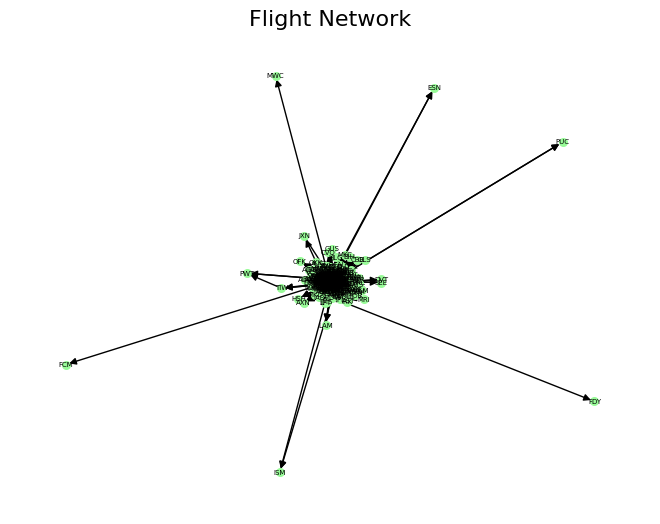

In [99]:
import matplotlib.pyplot as plt
pos = nx.spring_layout(flight_net, k=0.3, seed=42)
nx.draw(flight_net, pos, node_size=30, node_color='palegreen', with_labels=True, font_size=5)
plt.title("Flight Network", fontsize=16)
plt.show()

### 1.1 Analyzing the graph
The `analyze_graph_features` function from `functions.flight_net_analysis` analyzes a directed flight network graph by:

- **Graph Properties**: It calculates the number of nodes $N$ (airports), edges $E$ (flights), and density, $D = \frac{2E}{N(N-1)}$ and classifies the graph as sparse, dense, or moderate based on density thresholds.

- **Degree Analysis**: It computes in-degree, out-degree, and degree for each node ( calculated from scratch ), visualizing the distributions with histograms.

- **Hub Identification**: It identifies airports with degrees higher than the 90th percentile and returns them as hubs in a DataFrame.

The `summarize_graph_features` function provides a summary report of the graph's features.

Summary Report:
Number of nodes N = 469
Number of edges E = 29791
Density D = 0.2714540848869207
The graph is moderatly dense


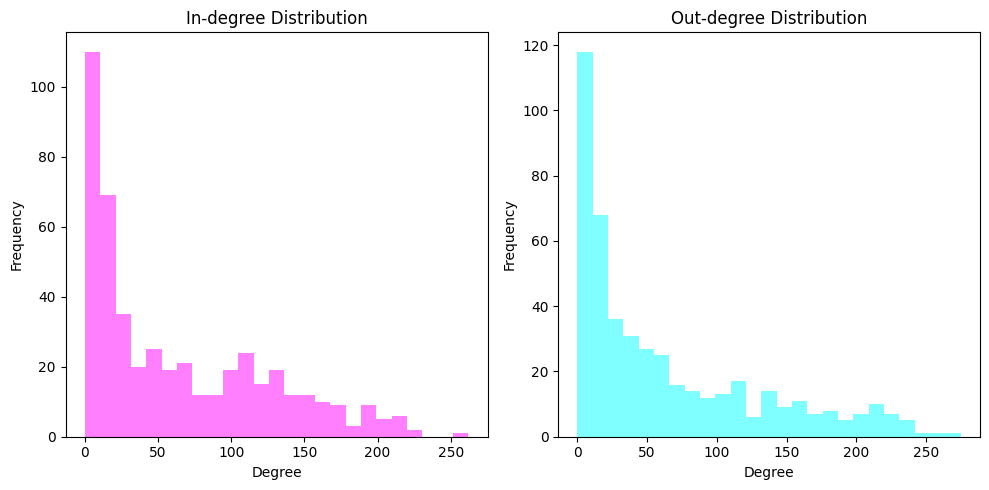

Hubs (airports with degree > 90th percentile):



,Airport,Degree
0,SLC,433
1,PHX,446
2,CMH,371
3,CLT,378
4,LGA,330
5,CLE,388
6,MCI,407
7,SFO,339
8,RDU,383
9,TYS,349


In [82]:
from functions import flight_net_analysis
from functions.flight_net_analysis import analyze_graph_features, summarize_graph_features
summarize_graph_features(flight_net)

These airports are "hubs" because they play a critical role in connecting different regions and are more influential in terms of their flight network. Their high degree indicates that they are well-connected, facilitating efficient transportation and passenger flow across the network. These airports likely have a combination of factors that contribute to their high degree: high connectivity, strategic location (e.g., ATL (Atlanta), ORD (Chicago O'Hare), and LAX (Los Angeles) ), high passenger traffic and airline presence.


Given the directed nature of the graph, an alternative approach to computing density is $ D = \frac{E}{N(N-1)} $. Using this formula, the calculated density is approximately 0.13572, classifying the graph as sparse.

In [93]:
import importlib
import functions.flight_net_analysis  # Assume your function is defined in my_module

# Reload the module
importlib.reload(functions.flight_net_analysis)

<module 'functions.flight_net_analysis' from 'c:\\Users\\Val\\Documents\\GitHub\\ADM_HM5\\functions\\flight_net_analysis.py'>

### 1.2 Passenger traffic and busiest routes
The function `passengers_flow` computes the total passenger flow for each (directed) flight by grouping the data by route, where the `route` column is created to represent directed connections using airport pairs as (Origin_airport, Destination_airport).

It returns the modified DataFrame with the new `route` and `flow_by_route` columns.

In [83]:
from functions.traffic import passengers_flow
passengers_flow(airports_df)[['Origin_airport','Destination_airport','Passengers', 'route','flow_by_route']].head()

,Origin_airport,Destination_airport,Passengers,route,flow_by_route
1,EUG,RDM,41,"(EUG, RDM)",24846
2,EUG,RDM,88,"(EUG, RDM)",24846
3,EUG,RDM,11,"(EUG, RDM)",24846
4,MFR,RDM,0,"(MFR, RDM)",492
5,MFR,RDM,11,"(MFR, RDM)",492


The function `buisiest_routes` computes the total passenger flow for each undirected route using the `passengers_flow` function. It then extracts the top-k routes with the highest total `passenger_flow` and creates a bar chart to visualize the results.

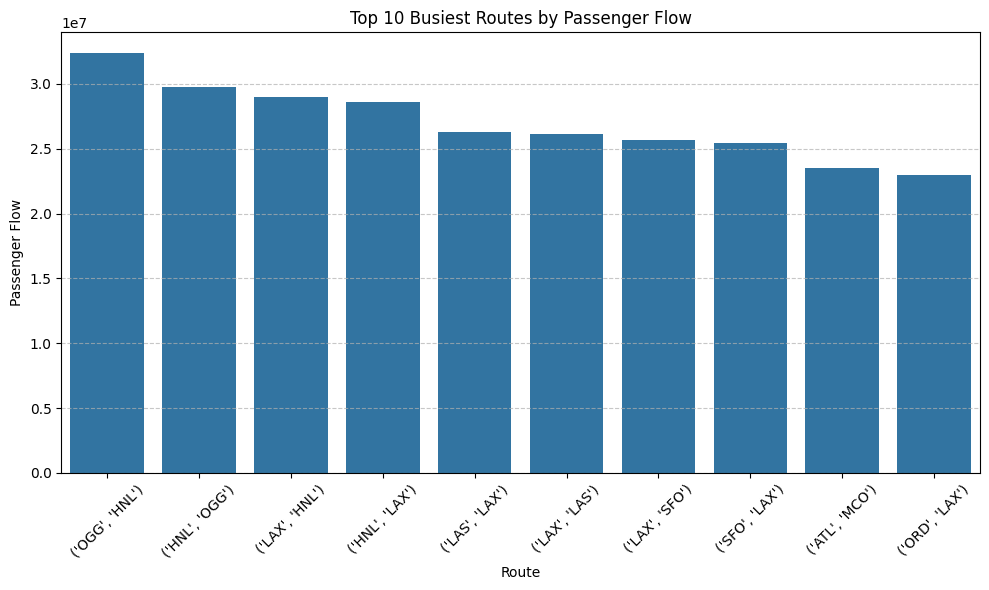

,route,flow_by_route
1654773,"(OGG, HNL)",32364612
1159163,"(HNL, OGG)",29744742
1644081,"(LAX, HNL)",28963545
3013844,"(HNL, LAX)",28631618
2968876,"(LAS, LAX)",26333721
2212255,"(LAX, LAS)",26177809
3438699,"(LAX, SFO)",25661782
2973079,"(SFO, LAX)",25458207
1326331,"(ATL, MCO)",23483751
3002794,"(ORD, LAX)",22979323


In [84]:
from functions.traffic import buisiest_routes
buisiest_routes(airports_df, 10)

### 1.3 Passenger Efficiency and  Connection Utilization 

The `routes_efficiency` function calculates the **passenger efficiency** as the average number of passengers per flight for each route: the sum of all passengers from airpot $i$ to airport $j$ over the number of flights from $i$ to $j$.

The `Average_passengers` per flight on the route from airport $i$ to airport $j$ is then:
$$ \text{Average\_passengers}(route)_{i \to j} = \frac{\sum_{k=1}^{n_{i \to j}} P_k}{n_{i \to j}}$$
where:

- $P_k$ is the number of passengers on the $k$-th flight from $i$ to $j$,
- $n_{i\to j}$ is the total number of flights between airport $i$ and airport $j$.

The highest $k$ averages are higlighted and visualized.

Finally it identifies the top $k$ over-utilized and under-utilized routes, where **connection utilization** is defined as a measure that compares demand (passengers) to capacity (seats).  This ratio represents how efficiently the available seats on a route are being filled with passengers. 

The utilization formula we consider is:

$$\text{utilization} = \frac{\text{Passengers}}{\text{Seats}}$$

This formula is consistent since we have excluded from the dataset all the flights with $Seats = 0$ in the data preprocessing, since they are not meaningful for our analysis.  Additionally, a small constant ($0.0001$) is added to the number of passengers to maintain the formula's validity and better differentiate flights with zero passengers. This adjustment ensures that flights with zero passengers and a high seat count are classified as more underutilized compared to those with zero passengers and a low seat count.

Top 10 routes by passenger efficiency :



,route,Average_passengers
3256852,"(MKC, IND)",940.0
2695382,"(HNL, PIT)",426.0
1656367,"(PIT, HNL)",426.0
1694062,"(ROW, JFK)",421.0
1650649,"(MKE, HNL)",408.0


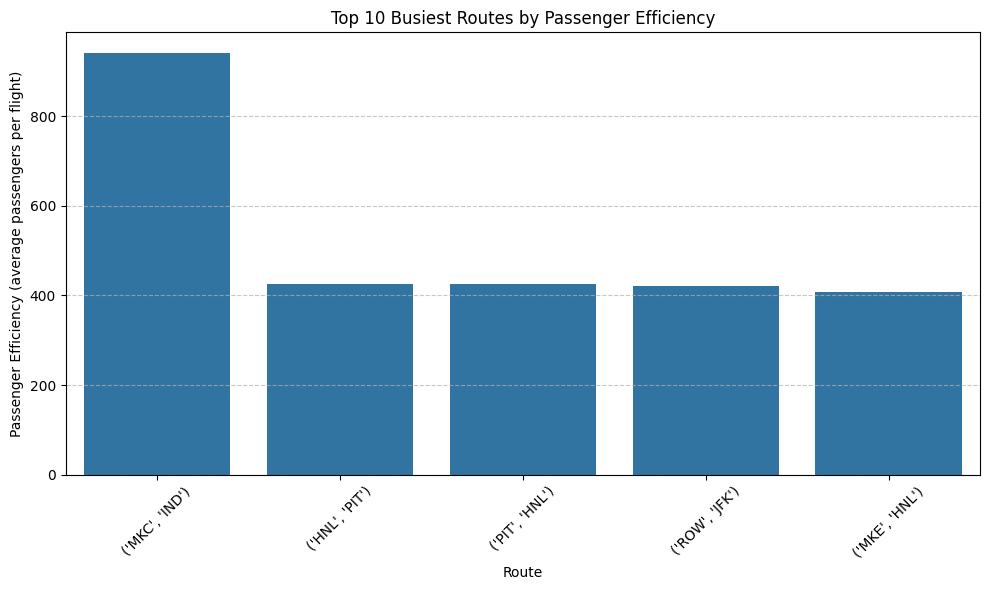

Top 10 over-utilized routes:



,route,Passengers,Seats,utilization
3341600,"(TTN, PHL)",1349,122,11.057378
1898495,"(SEA, ANC)",462,233,1.982833
2165887,"(DTW, LAS)",469,256,1.832032
1040966,"(ATL, IAH)",553,360,1.536111
1287123,"(FLL, MCO)",1205,792,1.521465
3045931,"(LAS, MSP)",355,236,1.504238
724490,"(LAS, ORD)",707,472,1.497882
724503,"(LAS, ORD)",705,472,1.493644
724418,"(LAS, ORD)",704,472,1.491526
2959944,"(LAS, LAX)",345,236,1.461865


Top 10 under-utilized routes:



,route,Passengers,Seats,utilization
212262,"(LGA, BOS)",0,34748,2.877863e-09
1655504,"(LAX, HNL)",0,21120,4.734848e-09
2351818,"(SJC, SNA)",0,18056,5.538325e-09
210294,"(MIA, BGR)",0,15514,6.445791e-09
337181,"(MDW, DFW)",0,10080,9.920635e-09
950943,"(EWR, DET)",0,9782,1.022286e-08
897905,"(JFK, ORD)",0,9600,1.041667e-08
1918972,"(ORD, ANC)",0,9600,1.041667e-08
1764186,"(ANC, JFK)",0,9600,1.041667e-08
592638,"(MEM, ATL)",0,8457,1.182452e-08


In [92]:
from functions.traffic import routes_efficiency
routes_efficiency(airports_df, 10)

Interactive map visualizing the geographic spread of the flight network.

In [63]:
!pip install folium

The `visualize` function implemented in `functions.netmap` generates a visual representation of a flight network using **Folium**, where airports (nodes) are added as markers, and flights (edges) are represented by colored polylines. The color reflects traffic levels (gray: low, green: medium, red: high), and the line thickness is proportional to the passenger count. Invalid nodes (missing coordinates) are excluded. Percentile thresholds (`p50`, `p99`) dynamically define traffic levels for better visualization. The final map provides an intuitive way to explore the network's structure and traffic patterns.

In [25]:
from functions.netmap import visualize
visualize(flight_net)

## 2 Nodes' Contribution (Q2)

### 2.1 Centrality Measures
The function `analyze_centrality`  implemented in `nodes_analysis.py` computes the following centrality measures for a given airport:

#### Betweeness centrality (Normalized)
Implemented in `calculate_betweenness function`, measures how often a node appears on the shortest paths between other nodes.

$$BC(v) = \frac{BC(v)}{(N-1)(N-2)}$$
Where:
- $ \sigma_{st} $ is the total number of shortest paths between nodes $s$ and $t$,
- $ \sigma_{st}(v) $ is the number of shortest paths passing through node $v$,
- $ N $ is the total number of nodes.

#### Closeness centrality:
Implemented in `analyze_centrality` function, measures how easily a node can access all other nodes in the network.
$$CC(v) = \frac{N-1}{\sum_{u \neq v} d(v, u)}$$
Where:
- $ d(v, u) $ is the shortest path distance from node $ v $ to node $ u $,
- $N$ is the total number of nodes.

#### Degree centrality
Implemented in `analyze_centrality` function, simply counts the number of direct connections to the node.
$$DC(v) = \frac{\deg(v)}{N-1}$$
Where:
- $ \deg(v) $ is the degree of node $v$,
- $ N $ is the total number of nodes.

#### PageRank 
Implemented in `pagerank` function, computes the "importance" of a node based on incoming connections and their weights.
$$PR(airport) = \frac{1 - \alpha}{N} + \alpha \sum_{u \in In(airport)} \frac{PR(u)}{out(u)}$$
Where:
- $ PR(airport)$ is the PageRank of the given airport;
- $\alpha$ is the damping factor (default to 0.85).
- $ N$ is the total number of nodes in the graph.
- $ In(v) $ are the nodes that link to node $v$.
- $ out(u) $ is the number of outgoing links from node $u$.


In order to compute Betweeness Centrality we first compute the shortest paths between any two nodes of the graph with the implementation of the *Dijkstra* Algorithm in the `Dijkstra` function.
Since our **flight_net** graph is weighted by **distance** attribute (in miles), and the task involves analyzing flight networks, it's reasonable to interpret "shortest paths" as the minimum weighted distances. In this approach, betweenness centrality will reflect how crucial a given airport is in facilitating shorter, efficient routes.

In [30]:
from functions.flight_net_analysis import analyze_centrality

centralities = analyze_centrality(flight_net, 'JFK')
print(f'JFK Centrality measures:\n', "\n".join([f"{key} = {value}" for key, value in centralities.items()]))


JFK Centrality measures:
 Betweenness = 0.007988799209355954
Closeness = 0.0007779462219739886
Degree = 0.7670940170940171
PageRank = 0.0021321961620469083


In [37]:
centralities = analyze_centrality(flight_net, 'LAX')
print(f'LAX Centrality measures:\n', "\n".join([f"{key} = {value}" for key, value in centralities.items()]))

LAX Centrality measures:
 Betweenness = 0.023421914749537875
Closeness = 0.0006526058915809656
Degree = 0.8547008547008547
PageRank = 0.0021321961620469083


### 2.2 Centrality Measures Distribution

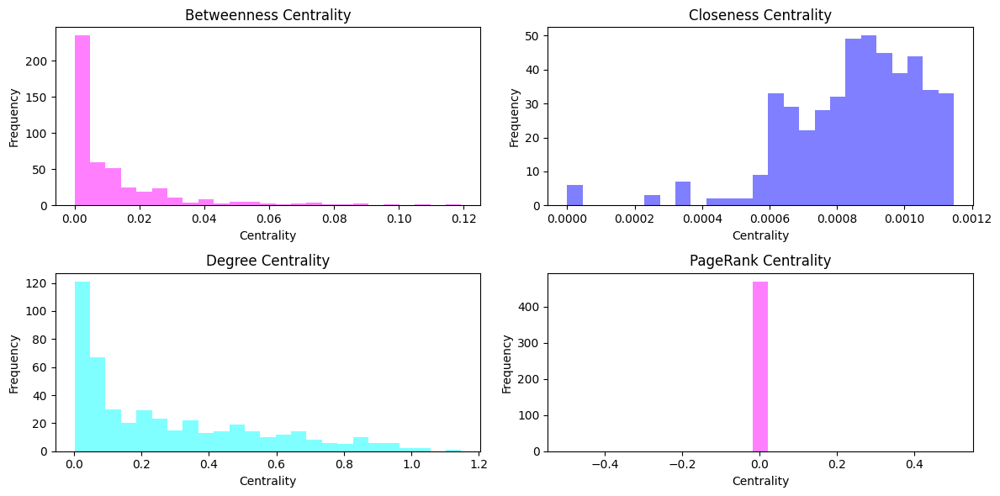


Top 5 Airports for Each Centrality Measure:


,Betweenness,Closeness,Degree,PageRank
0,MSP (0.11922),STL (0.00115),MSP (1.14744),YNG (0.00213)
1,SBN (0.10581),COU (0.00115),ORD (1.04915),ABI (0.00213)
2,MCI (0.09561),MCI (0.00114),ATL (1.02778),HIF (0.00213)
3,ABQ (0.08702),SPI (0.00114),LAS (0.96795),ALO (0.00213)
4,MDW (0.08682),SUS (0.00114),DFW (0.96795),MWH (0.00213)


In [94]:
from functions.flight_net_analysis import compare_centralities
compare_centralities(flight_net)

### Summary of Centrality Distributions:

1. **Betweenness Centrality**:

   The Betweenness distribution is **highly skewed**: most nodes have betweenness centrality near zero. This suggests that only *a small number* of nodes act as *critical connections* (e.g., major *hubs* like MSP) in the network, while the majority are not on many shortest paths, meaning they are most likely peripheral.

2. **Closeness Centrality**:

   The Closeness distribution is spread more evenly than betweenness, but still concentrated toward the lower end of the range. This reflects that many nodes in the network are *far from others* (due to sparsity or disconnected components), suggesting *regional clusters* or poorly connected nodes in the network.

3. **Degree Centrality**:

   Its **skewed** distribution, with many nodes having low degrees and only a few high-degree hub nodes, captures the structure of the graph, where most nodes have few direct connections (small airports), but some nodes are central hubs with significantly higher degrees (e.g., ORD, ATL).

4. **PageRank Centrality**:

   Relatively uniform and less skewed; all nodes have small but non-zero centrality values, as PageRank assigns some *importance to every node*.
   Such measure captures the interconnected nature of the network, assigning even peripheral airports some level of importance.

---

### 2.3 LLM centrality measure
*'Ask LLM (eg. ChatGPT) to suggest alternative centrality measures that might be relevant to this task. How can you check that the results given by the LLM are trustable?'*

#### Prompt:

"I am studying a flight network and I have explored its nodes (airports) and edges (flights) using the following centrality measures: Closeness Centrality, Degree Centrality, Betweenness Centrality and PageRank. Which alternative centrality measures might be relevant to this task?"

#### ChatGPT Response:

In addition to the centrality measures you've already explored, here are a few alternative centrality measures that might be relevant for your flight network:

1. **Eigenvector Centrality**: This measure evaluates the influence of a node based on the importance of its neighbors. It is particularly useful for identifying airports that are well-connected to other highly influential airports, rather than just focusing on direct connections (as in degree centrality).

2. **Katz Centrality**: Similar to eigenvector centrality but with a damping factor that gives less importance to distant connections. It can be used to highlight nodes that have influence within a specific "range" of connections.

3. **Harmonic Centrality**: A variant of closeness centrality, it computes centrality based on the sum of the inverse shortest path distances from a node to all other nodes. It's useful in cases where you want to account for the global reachability of airports, especially when some airports may have very long paths to others.

4. **Local Clustering Coefficient**: While not a centrality measure in the strictest sense, this measure assesses the degree to which nodes tend to cluster together. It can help identify airports that are part of dense sub-networks or hub-and-spoke structures.

5. **Community-based Centrality**: Centrality measures based on community detection, such as **modularity centrality** or **membership centrality**, can help identify airports that are central within certain communities or clusters of airports, which may be particularly useful for understanding regional hubs or networks of closely connected airports.

6. **Flow Betweenness Centrality**: This variant of betweenness centrality accounts for the flow of resources (such as passengers or goods) between nodes. It can give a more nuanced view of centrality, especially in a network where the weight or capacity of the edges (flights) varies.

7. **Transit Centrality**: This is another variant of betweenness centrality that considers the number of travelers passing through an airport. It emphasizes the flow of passengers rather than just the shortest path connections.

Each of these measures can provide additional insights into the importance and roles of airports in the flight network, depending on the context and goals of your analysis.

#### Reliability check:
To assess the reliability of the LLM results, we cross-verified with trusted sources, such as academic papers, textbooks, and reputable websites. We also refined our prompt by adding relevant information reguarding our **graph features** (number of nodes, edges, density, connectness, etc.) to check which measure would suite best our case.

### Eigen Vector Centrality Implementation
Eigenvector centrality highlights nodes connected to other highly connected nodes. This could provide a complementary perspective to PageRank,
since it should emphasize airports that have indirect importance through their connections to influential hubs.
Since Eigen Vector Centrality requires a connected graph to properly propagate centrality scores among nodes, but our network is not, we can use it to study the largest connected component, if such is "large" enough.

In [ ]:
# checking connectness properties
print(f" The graph is strongly connected: {nx.is_strongly_connected(flight_net)}\n "
      f"The graph is weakly connected: {nx.is_weakly_connected(flight_net)}\n"
      f" Number of strongly connected components: {len(list(nx.strongly_connected_components(flight_net)))} \n")

 The graph is strongly connected: False
 The graph is weakly connected: True
 Number of strongly connected components: 8 



In [56]:
# creating a subgraph from the largest strongly connected component and cheching its size
largest_cc = max(nx.strongly_connected_components(flight_net), key=len)
subgraph = flight_net.subgraph(largest_cc)
len(subgraph.nodes())

462

The largest (strongly) connected component has 462 nodes out of the 469 total nodes of the original flight network. Including 98.5% of the graph’s nodes,  this means we are analyzing nearly the entire structure: the 7 nodes outside the largest SCC are likely isolated or weakly connected substructures. Their importance in terms of eigenvector centrality is minimal, so excluding them sounds appropriate.

We can further verify this through the initial graph structure visualization, where at least six nodes appeared compleatly isolated from the rest of the network.

Eigen Vector Centrality Implementation Steps (`eigenvector_centrality`):

- Represent the largest SCC with its adjecy matrix: implemented in `adj_matrix` function;
- Initialize a centrality vector $x$, where all nodes start with equal scores ;
- Iteratively update the centrality scores $x_{new} =  A x_{old}$;
- Normalize $x_{new}$ after each iteration to prevent it from growing indefinitely;
- Repeat until convergence.

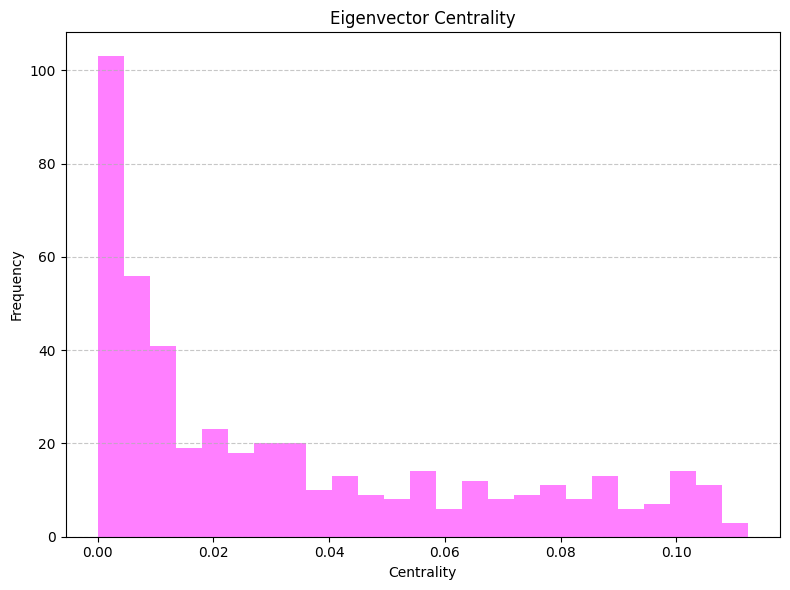

In [61]:
from functions.flight_net_analysis import adj_matrix, eigenvector_centrality

adjency_matrix, node_idx = adj_matrix(subgraph)
EC = eigenvector_centrality(adjency_matrix)

In [95]:
#visualizing top and worst nodes by EC centrality score
node_names = list(subgraph.nodes)  # List of airports

# Map the eigenvector centrality scores to the corresponding nodes
sorted_indices = np.argsort(EC)[::-1]  # Sort the eigenvector centrality in descending order

# Map sorted indices to node names
sorted_node_names = [node_names[i] for i in sorted_indices]
sorted_scores = EC[sorted_indices]

# Top 5 and worst 5
top_5 = [(sorted_node_names[i], sorted_scores[i]) for i in range(5)]
worst_5 = [(sorted_node_names[i], sorted_scores[i]) for i in range(-5, 0)]

# Step 4: Display top 5 and worst 5 in a DataFrame
top_5_df = pd.DataFrame({
    'Top 5 Airports by Eigenvector Centrality': [f"{airport} ({score:.5f})" for airport, score in top_5]
})
worst_5_df = pd.DataFrame({
    'Worst 5 Airports by Eigenvector Centrality': [f"{airport} ({score:.5f})" for airport, score in worst_5]
})

# Print the results
display(top_5_df)
display(worst_5_df)


,Top 5 Airports by Eigenvector Centrality
0,MSP (0.11229)
1,ORD (0.11165)
2,ATL (0.10984)
3,DFW (0.10664)
4,CVG (0.10605)


,Worst 5 Airports by Eigenvector Centrality
0,MRI (0.00046)
1,OFK (0.00025)
2,POU (0.00023)
3,SEE (0.00006)
4,DVT (0.00006)


### Insights:
Airports with the highest eigenvector centrality are the most influential and interconnected in the network. These nodes are not only well-connected but also linked to other influential airports, highlighting their strategic importance.

This measure also indicates **vulnerability**: if a critical node faces issues (e.g., weather, strikes), the impact could ripple through the network, affecting other airports connected to it.

Eigenvector centrality adds depth to the analysis by focusing on the quality of connections, identifying nodes that are significant due to their ties to influential neighbors. Unlike degree centrality, which counts direct connections, eigenvector centrality gives more weight to connections with key nodes. It also complements other measures like betweenness centrality and closeness centrality, which focus on intermediary roles and proximity, respectively.

While PageRank, a variant of eigenvector centrality, accounts for random behavior with a damping factor, eigenvector centrality offers a clearer measure of node influence, emphasizing direct influence in the network. The choice between the two depends on whether random behavior (PageRank) or direct influence (eigenvector centrality) is more relevant for the analysis. Moreover, while PageRank, with its focus on random behavior, might model some aspects of how passengers might "randomly" switch routes, eigenvector centrality better reflects the real-world dynamics of a flight network, where key airports drive the structure and connectivity of the entire system. This is because the flow of passengers and flights is primarily determined by established routes and the connectivity between airports rather than random jumps, thus, eigenvector centrality provides a clearer understanding of airport influence and vulnerability in such a network.

------

## 3. Finding Best Routes (Q3)

In [ ]:
from pyvis.network import Network
from matplotlib import pyplot as plt
from collections import deque
import nest_asyncio
import heapq
from itertools import combinations
from multiprocessing import Pool, cpu_count
from tqdm import tqdm
import random

nest_asyncio.apply()

Whenever you plan to fly to a specific city, your goal is to find the most efficient and fastest flight to reach your destination. In the system you are designing, the best route is defined as the one that minimizes the total distance flown to the greatest extent possible.

- In this task, you need to implement a function that, given an origin and destination city, determines the best possible route between them. To simplify, the focus will be limited to flights operating on a specific day.

__Note__: Each city may have multiple airports; in such cases, the function should calculate the best route for every possible airport pair between the two cities. For example, if city $A$ has airports $a_1, a_2$ and  city B has $b_1, b_2$, the function should compute the best routes for $a_1 \rightarrow b_1$, $a_1 \rightarrow b_2$, $a_2 \rightarrow b_1$ and $a_2 \rightarrow b_2$. If it’s not possible to travel from one airport in the origin city to another airport in the destination city on that date, you must report it as well.

The function takes the following inputs:
1. Flights network
2. Origin city name
3. Destination city name
4. Considered Date (in yyyy-mm-dd format)

The function output:
1. A table with three columns: 'Origin_city_airport', 'Destination_city_airport', and the 'Best_route'.

__Note__: In the "Best_route" column, we expect a list of airport names connected by $\rightarrow$, showing the order in which they are to be visited during the optimal route. If no such route exists, the entry should display "No route found."

### **Create Weighted Net**
For this task was created a weighted flights' directed graph where weights are `Distance` between `Origin_airport` and `Destination_airport`.

In [158]:
weighted_flight_net = nx.DiGraph()
    
# Add edges into net
for _, row in airports_df.iterrows():
    origin = row['Origin_airport']
    destination = row['Destination_airport']
    # Use distance as weight
    distance = row['Distance']
        
    # Add the edge with distance as the weight
    weighted_flight_net.add_edge(origin, destination, weight=distance)

To verify correctness of created graph let's show nodes and adges that are stored now in `weighted_flight_net`.

In [159]:
print("Nodes:", list(weighted_flight_net.nodes())[:10])
print("Edges:", list(weighted_flight_net.edges(data=True))[:10])

Nodes: ['MHK', 'AMW', 'EUG', 'RDM', 'MFR', 'SEA', 'PDX', 'LMT', 'SFO', 'LAX']
Edges: [('MHK', 'AMW', {'weight': 254}), ('MHK', 'HYS', {'weight': 142}), ('MHK', 'ACT', {'weight': 520}), ('MHK', 'CAK', {'weight': 816}), ('MHK', 'FAR', {'weight': 537}), ('MHK', 'MIA', {'weight': 1323}), ('MHK', 'TMB', {'weight': 1325}), ('MHK', 'OFF', {'weight': 142}), ('MHK', 'TUL', {'weight': 208}), ('MHK', 'AUS', {'weight': 619})]


### **Create `find_best_route` function**

Preseudocode of **Dijkstra alghoritm** to find shortest path from the source node to the target node.

```plaintext
Function DijkstraShortestPath(graph, source, target)
"""
Dijkstra's Algorithm to find the shortest path and its length.

Parameters:
    graph: Weighted directed flight network.
    source: Starting node (origin airport).
    target: Destination node (destination airport).

Returns:
    path: List of nodes in the shortest path from origin airport to destination airport.
    total_distance: Total distance of the shortest path.
"""
    # Create priority queue: [(current_distance, current_node, path)]
    pq ← [(0, source, [])]
    # Initialize a dictionary to store visited nodes and their distances
    visited ← {}

    # Iterate priority queue while there is no nodes in it
    While pq is not empty:
        # Pop node with the smallest edge weight (Distance)
        current_distance, current_node, path ← HeapPop(pq)

        # Skip the node if it has already been visited
        If current_node is visited:
            Continue
        End If

        # Mark the current node as visited and store its distance
        visited[current_node] ← current_distance

        # Add the current node to the visited path
        path ← path + [current_node]

        # If the target node is reached, return the path and total distance
        If current_node == target:
            Return path, current_distance

        # Explore all neighbors of the current node
        For each neighbor in current_node's neighbors:
            If neighbor is not visited:
                # Retrieve the edge weight from current_node to neighbor
                edge_weight ← graph[current_node][neighbor].Get('weight', ∞)

                # Push the neighbor's node into the priority queue with the updated distance
                HeapPush(pq, (current_distance + edge_weight, neighbor, path))

    # If no path exists from source to target, return None for the path and infinity for the distance.
    Return None, ∞
End Function
```

**Sources**:
- Graph Data Structure 4. Dijkstra’s Shortest Path Algorithm: https://youtu.be/pVfj6mxhdMw?si=_oNn0vGPPOv5G4H8

In [160]:
def dijkstra_shortest_path(graph, source, target):
    """
    Dijkstra's Algorithm to find the shortest path and its length.

    Parameters:
        graph: wightted directed flight network.
        source: Starting node (origin airport).
        target: Destination node (destination airport).

    Returns:
        path: List of nodes in the shortest path from origin airport to destination airport.
        total_distance: Total distance of the shortest path.
    """
    # Priority queue that stores: [(current_distance, current_node, path)]
    # Example: 
    # [(0, 'AMW', [])]
    # [(254, 'MHK', ['AMW'])]
    # [(310, 'FOE', ['AMW', 'MHK']), (312, 'SLN', ['AMW', 'MHK']), (372, 'LNK', ['AMW', 'MHK']), ...]
    pq = [(0, source, [])]
    
    # Dictionary with visited nodes
    visited = {}

    while pq:
        # print(pq)
        # Get the node with the smallest distance
        current_distance, current_node, path = heapq.heappop(pq)
        
        # Skip the node if it has already been visited
        if current_node in visited:
            continue
        
        # Mark the current node as visited
        visited[current_node] = current_distance
        
        # Add the current node to the path
        path = path + [current_node]
        
        # If the target node is reached, return the path and total distance
        if current_node == target:
            return path, current_distance
        
        # Explore neighbors of the current node
        for neighbor in graph.neighbors(current_node):
            # If the neighbor hasn't been visited
            if neighbor not in visited:
                # Retrieve the distance of the edge from current_node to neighbor
                edge_weight = graph[current_node][neighbor].get('weight', float('inf'))
                
                # Push the neighbor into the priority queue with the updated distance
                heapq.heappush(pq, (current_distance + edge_weight, neighbor, path))
    
    # If no path exists, return None and infinity for the distance
    return None, float('inf')

To test it on sample were picked `Origin_airport="AMW"` and `Destination_airport="HYS"`. The function's output is a tuple of the ordered list with nodes of the shortest path and the total distance.

In [161]:
origin = "AMW"
destination = "HYS"
dijkstra_shortest_path(weighted_flight_net, origin, destination)

(['AMW', 'MHK', 'HYS'], 396)

### **Steps to find shortest path from origin to destination city**

1. Filter input flight gragh by date.
2. Find all available airports from `Origin_city` and airports from `Destination_city` on chosen date.
3. For all possible combinations of airports from `Origin_city` to `Destination_city` find shortest path using **Dijkstra's Algorithm**.
4. Find minimum distance path among retrieved destinations.


In [162]:
def filter_cities_by_date(flight_net, date):
    """
    Filters the flight network to include only the flights available on the specified date.

    Parameters:
        flight_net (networkx.Graph): The complete flight network graph.
        date (str): The date to filter the graph (in yyyy-mm-dd format).

    Returns:
        networkx.Graph: A subgraph of the flight network containing only flights on the specified date.
    """
    # Filter cities by date
    cities_filtered = airports_df[airports_df["Fly_date"] == date][["Origin_airport", "Destination_airport"]]
    nodes_to_keep = pd.concat([cities_filtered["Origin_airport"], cities_filtered["Destination_airport"]]).unique()
    
    # Return the subgraph filtered by date
    return flight_net.subgraph(nodes_to_keep).copy()

def check_if_nodes_in_graph(nodes, graph_nodes, city, isOrigin):
    """
    Checks whether the given list of nodes exists in the graph and returns only the available nodes.

    Parameters:
        nodes (list): A list of node names to check.
        graph_nodes (list): The list of nodes available in the graph.
        city (str): The city name associated with the nodes.
        isOrigin (bool): Indicates whether the nodes are origin nodes (True) or destination nodes (False).

    Returns:
        list: A list of nodes available in the graph.
    """
    filtered_nodes = [node for node in nodes if node in graph_nodes]
    if len(filtered_nodes) != len(nodes):
        print(f"Airports that are not available from {'origin' if isOrigin else 'destination'} city '{city}': {set(nodes) - set(filtered_nodes)}")
    return filtered_nodes

def get_airports_by_city(city, graph_nodes, isOrigin=True):
    """
    Retrieves the list of airports in a specific city and checks their availability in the graph.

    Parameters:
        city (str): The name of the city.
        graph_nodes (list): The list of nodes available in the graph.
        isOrigin (bool): Indicates whether to retrieve origin airports (True) or destination airports (False).

    Returns:
        list: A list of airports in the specified city that are present in the graph.
    """
    if isOrigin:
        return check_if_nodes_in_graph(airports_df[airports_df["Origin_city"].str.strip() == city]["Origin_airport"].unique().tolist(), graph_nodes, city, isOrigin)
    else:
        return check_if_nodes_in_graph(airports_df[airports_df["Destination_city"].str.strip() == city]["Destination_airport"].unique().tolist(), graph_nodes, city, isOrigin)
    
def find_optimal_route_from_multiple(results):
    """
    Finds the optimal route(s) with the minimum total distance from the list of results.

    Parameters:
        results (list): A list of dictionaries, each containing:
                        - 'Origin_city_airport'
                        - 'Destination_city_airport'
                        - 'Best_route'
                        - 'Total_distance'

    Returns:
        pd.DataFrame: A DataFrame with the optimal routes.
    """
    # Filter out results with 'None' distances
    valid_results = [result for result in results if result['Total_distance'] is not None]

    if not valid_results:
        print("No valid routes found.")
        return pd.DataFrame([], columns=['Origin_city_airport', 'Destination_city_airport', 'Best_route'])
    
    # Find the minimum total distance among valid results
    min_distance = min(result['Total_distance'] for result in valid_results)

    # Find all results with the minimum total distance
    min_results = [result for result in valid_results if result['Total_distance'] == min_distance]

    return pd.DataFrame(min_results, columns=['Origin_city_airport', 'Destination_city_airport', 'Best_route'])

def find_best_route(flight_net, origin, destination, date):
    """
    Finds the best route(s) between the origin and destination cities for a given date.

    Parameters:
        flight_net (networkx.Graph): The flight network graph.
        origin (str): The origin city name.
        destination (str): The destination city name.
        date (str): The date to consider for the flight (in yyyy-mm-dd format).

    Returns:
        pd.DataFrame: A DataFrame containing the best route(s) with columns:
                      - 'Origin_city_airport'
                      - 'Destination_city_airport'
                      - 'Best_route'
    """
    print(f"Flight date: {date}")
    print(f"Total Graph Nodes in the Flight Net: {len(flight_net.nodes())}")
    
    # Create the subgraph filtered by date
    filtered_graph = filter_cities_by_date(flight_net, date)
    print(f"Available Graph Nodes: {len(filtered_graph.nodes())}")

    print("-" * 50)
    # Get all airports for origin and destination cities
    origin_airports = get_airports_by_city(origin, filtered_graph)
    destination_airports = get_airports_by_city(destination, filtered_graph, isOrigin=False)
    
    print(f"Origin airports in {origin}: {origin_airports}")
    print(f"Destination airports in {destination}: {destination_airports}")
    print("-" * 50)

    # Find the best routes
    print("All possible routes:")
    results = []
    for origin_airport in origin_airports:
        for destination_airport in destination_airports:
            try:
                # Find the shortest path using Dijkstra's algorithm
                path, total_distance = dijkstra_shortest_path(graph=filtered_graph, source=origin_airport, target=destination_airport)
                print(f"- Path from {origin_airport} to {destination_airport}: {path} ({total_distance})")
                
                # Append the route to results
                results.append({
                    'Origin_city_airport': origin_airport,
                    'Destination_city_airport': destination_airport,
                    'Best_route': ' → '.join(path) if path is not None else 'No route found',
                    'Total_distance': total_distance if path is not None else None
                })
            except Exception as e:
                print(f"Error finding path from {origin_airport} to {destination_airport}: {e}")
                results.append({
                    'Origin_city_airport': origin_airport,
                    'Destination_city_airport': destination_airport,
                    'Best_route': 'No route found',
                    'Total_distance': None
                })
    
    return find_optimal_route_from_multiple(results)

#### **Case: 'No route found'**

In `Origin_city` 'Aberdeen, SD' there is one airport 'ABR', but the flight is not available on date '1993-02-01'. The same is right also for `Destination_city` 'Zanesville, OH' - 'ZZV'.

In [163]:
find_best_route(weighted_flight_net, "Aberdeen, SD", "Zanesville, OH", "1993-02-01")


Flight date: 1993-02-01
Total Graph Nodes in the Flight Net: 727
Available Graph Nodes: 250
--------------------------------------------------
Airports that are not available from origin city 'Aberdeen, SD': {'ABR'}
Airports that are not available from destination city 'Zanesville, OH': {'ZZV'}
Origin airports in Aberdeen, SD: []
Destination airports in Zanesville, OH: []
--------------------------------------------------
All possible routes:
No valid routes found.


,Origin_city_airport,Destination_city_airport,Best_route


#### **Case: 'Route found'**
Both Origin and Destination cities have multiple airports. The function `find_best_route` is checking all possible combination and then picks the best route (with min distance) among them.

In [164]:
find_best_route(weighted_flight_net, "Anchorage, AK", "Chicago, IL", "1993-02-01")

Flight date: 1993-02-01
Total Graph Nodes in the Flight Net: 727
Available Graph Nodes: 250
--------------------------------------------------
Airports that are not available from origin city 'Anchorage, AK': {'MRI'}
Airports that are not available from destination city 'Chicago, IL': {'CHI', 'II2', 'PWK', 'DPA'}
Origin airports in Anchorage, AK: ['ANC', 'EDF']
Destination airports in Chicago, IL: ['ORD', 'MDW', 'CGX']
--------------------------------------------------
All possible routes:
- Path from ANC to ORD: ['ANC', 'ORD'] (2846)
- Path from ANC to MDW: ['ANC', 'ORD', 'MDW'] (2862)
- Path from ANC to CGX: ['ANC', 'FAR', 'CID', 'SPI', 'CGX'] (3078)
- Path from EDF to ORD: ['EDF', 'ORD'] (2839)
- Path from EDF to MDW: ['EDF', 'ORD', 'MDW'] (2855)
- Path from EDF to CGX: ['EDF', 'MSP', 'SPI', 'CGX'] (3080)


,Origin_city_airport,Destination_city_airport,Best_route
0,EDF,ORD,EDF → ORD


## 4. Airline Network Partitioning (Q4)

Imagine all these flights are currently managed by a single airline. However, this airline is facing bankruptcy and plans to transfer the management of part of its operations to a different airline. The airline is willing to divide the flight network into two distinct partitions, $p_1$ and $p_2$, such that no flights connect any airport in $p_1$ to any airport in $p_2$. The flights in $p_1$ will remain under the management of the original airline, while those in $p_2$ will be handed over to the second airline. Any remaining flights needed to connect these two partitions will be determined later.

- In graph theory, this task is known as a graph disconnection problem. Your goal is to write a function that removes the minimum number of flights between airports to separate the original flight network into two disconnected subgraphs.

The function takes the following inputs:
1. Flight network

The function outputs:
1. The flights removed to disconnect the graph.
2. Visualize the original flight network.
3. Visualize the graph after removing the connections and highlight the two resulting subgraphs.

__Note:__ In this task, airline only concerned with the flights between airports, and the flight times are not relevant.

### **Create Network**
In the graph for the following task nodes are airports and edges' weight is the sum of flights.

In [165]:
# Aggregate rows by Origin_airport and Destination_airport, summing the Flights
aggregated_df = airports_df.groupby(['Origin_airport', 'Destination_airport'], as_index=False)['Flights'].sum()

# Initialize the directed graph
flight_net = nx.DiGraph()

# Add edges into the graph with aggregated weights
for _, row in aggregated_df.iterrows():
    origin = row['Origin_airport']
    destination = row['Destination_airport']
    flights = row['Flights']

    # 1. Skip self loops
    # 2. Skip edges without any flights (Flights==0)
    if origin == destination or flights == 0:
        continue

    # Add the edge with flights as the weight
    flight_net.add_edge(origin, destination, weight=flights)

print(f"Number of nodes: {flight_net.number_of_nodes()}")
print(f"Number of edges: {flight_net.number_of_edges()}")

Number of nodes: 727
Number of edges: 36386


### **Min-Cut Alghoritm**

#### **The Max-Flow Min-Cut theorem**
> The max-flow min-cut theorem states that in a flow network, the maximum amount of flow passing from the source to the sink is equal to the total weight of the edges in a minimum cut, i.e., the smallest total weight of the edges which if removed would disconnect the source from the sink.

The `minimum_cut` function implements the Max-Flow Min-Cut theorem for directed graphs to find the minimum set of edges that disconnect the graph into two parts. The steps involve:

1. **Building a Residual Graph**: This graph stores the remaining capacities of edges during the flow calculations.
2. **Finding Maximum Flow**: Repeatedly find augmenting paths using BFS and update the residual graph by reducing capacities along the path.
3. **Identifying Reachable Nodes**: After achieving maximum flow, find nodes reachable from the source in the residual graph.
4. **Calculating Minimum Cut Edges**: Identify edges in the original graph where reachable nodes connect to non-reachable nodes. These edges form the minimum cut.

This algorithm balances efficiency by leveraging the residual graph for augmenting path discovery and correctness by adhering to the Max-Flow Min-Cut theorem.

---

Pseudocode for **Minimum Cut Alghoritm**

```
Function MinimumCut(graph, source, sink)
"""
Finds the minimum cut in a directed graph using the Max-Flow Min-Cut theorem.

Parameters:
    graph: Weighted directed flight network.
    source: Starting node (source airport).
    sink: Ending node (sink airport).

Returns:
    cut_value: Total value of the minimum cut (sum of weights of cut edges).
    min_cut_edges: List of edges in the minimum cut.
"""

# Initialize residual graph with capacities
residual_graph ← Create a copy of the graph
For each edge (u, v) in graph:
    Add reverse edge (v, u) to residual_graph if not present
    Set capacity of (u, v) and (v, u) to weight or default value (1)

# Find Maximum Flow using BFS
max_flow ← 0
While augmenting path exists (BFS on residual_graph from source to sink):
    path ← List of nodes in the augmenting path
    bottleneck ← Minimum capacity along the path
    Update residual capacities along the path
    max_flow ← max_flow + bottleneck

# Identify reachable and non-reachable nodes
reachable_nodes ← BFS from source in residual_graph
non_reachable_nodes ← All nodes in graph - reachable_nodes

# Determine Minimum Cut Edges
min_cut_edges ← []
For each node u in reachable_nodes:
    For each neighbor v of u in graph:
        If v in non_reachable_nodes:
            Add (u, v) to min_cut_edges

Return max_flow, min_cut_edges

End Function
```

**Sources**:
- Max Flow Min Cut Therem: https://en.wikipedia.org/wiki/Max-flow_min-cut_theorem
- Minimum Cut Graphs: https://www.baeldung.com/cs/minimum-cut-graphs
- How can I find the minimum cut on a graph using a maximum flow algorithm?: https://stackoverflow.com/questions/4482986/how-can-i-find-the-minimum-cut-on-a-graph-using-a-maximum-flow-algorithm
- Finding minimum cut edges in a graph: https://stackoverflow.com/questions/5810703/finding-minimum-cut-edges-in-a-graph

In [166]:
def minimum_cut(graph, source, sink):
    """
    Custom implementation of minimum cut using Max-Flow Min-Cut theorem for a directed NetworkX graph.

    Parameters:
        graph (nx.DiGraph): Directed graph with edge weights as flights number.
        source (str): Source node.
        sink (str): Sink node.

    Returns:
        cut_value (int): Value of the minimum cut.
        min_cut_edges (list): List of edges in the minimum cut.
    """
    # Create the residual graph
    residual_graph = graph.copy()
    for u, v, data in graph.edges(data=True):
        # Add reverse edges with 0 initial capacity if not present
        if not residual_graph.has_edge(v, u):
            residual_graph.add_edge(v, u, capacity=0)
        else:
            residual_graph[v][u]['capacity'] = 0

    # Ensure all edges have a 'capacity' attribute
    for u, v in residual_graph.edges:
        if 'capacity' not in residual_graph[u][v]:
            residual_graph[u][v]['capacity'] = residual_graph[u][v].get('weight', 1)

    # Find maximum flow using BFS
    def bfs_find_augmenting_path(residual, src, dest):
        """
        Find an augmenting path in the residual graph using BFS.
        """
        parent = {node: None for node in residual.nodes()}
        visited = set()
        queue = deque([src])
        visited.add(src)

        while queue:
            current = queue.popleft()
            for neighbor in residual.successors(current):
                # Follow positive capacity edges
                if neighbor not in visited and residual[current][neighbor]['capacity'] > 0:  
                    parent[neighbor] = current
                    if neighbor == dest:
                        # Reconstruct path
                        path = []
                        while neighbor:
                            path.insert(0, neighbor)
                            neighbor = parent[neighbor]
                        return path
                    queue.append(neighbor)
                    visited.add(neighbor)
        return None

    max_flow = 0
    while True:
        path = bfs_find_augmenting_path(residual_graph, source, sink)
        if not path:
            break

        # Find the bottleneck capacity
        bottleneck = float('inf')
        for i in range(len(path) - 1):
            u, v = path[i], path[i + 1]
            bottleneck = min(bottleneck, residual_graph[u][v]['capacity'])

        # Update residual capacities along the path
        for i in range(len(path) - 1):
            u, v = path[i], path[i + 1]
            residual_graph[u][v]['capacity'] -= bottleneck
            residual_graph[v][u]['capacity'] += bottleneck

        max_flow += bottleneck

    # Find reachable nodes in the residual graph
    reachable = set()
    queue = deque([source])
    while queue:
        current = queue.popleft()
        if current in reachable:
            continue
        reachable.add(current)
        for neighbor in residual_graph.successors(current):
            if residual_graph[current][neighbor]['capacity'] > 0 and neighbor not in reachable:
                queue.append(neighbor)

    # Nodes not reachable from the source
    non_reachable = set(graph.nodes()) - reachable

    # Identify the minimum cut edges
    min_cut_edges = []
    for u in reachable:
        for v in graph.successors(u):
            # Use original graph for edge validation
            if v in non_reachable and 'weight' in graph[u][v]:
                min_cut_edges.append((u, v))

    return max_flow, min_cut_edges

#### **Pair Picking Issue (source, sink)**
Since in the task it is not specified the flight's date or any other information about `source` or `sink` node for **Min-Cut Problem**. We decided to pick the pair randomly. For the current test we chose 10000 pair out of 720 pair combinations. 

To speed up computing min cuts we used multiprocessing approach.

In [167]:
def process_pair(args):
    graph, source, sink = args
    return minimum_cut(graph, source, sink)

def run_mincut(graph, pairs_number=10000):
    nodes = list(graph.nodes())

    # Generate pairs_number random pairs (source, sink)
    pairs = random.sample([(source, sink) for source in nodes for sink in nodes if source != sink], pairs_number)

    # Use multiprocessing pool to compute mincut for pairs_number random pairs
    with Pool(cpu_count()) as pool:
        results = list(tqdm(pool.imap(process_pair, [(graph, source, sink) for source, sink in pairs]),
                            total=pairs_number, desc="Processing Pairs"))

    return results

In [168]:
results = run_mincut(flight_net)

Processing Pairs: 100%|██████████| 10000/10000 [17:17<00:00,  9.64it/s]


The function `find_best_minimum_cut` returns min min cut from 10000 possible pairs of (source, sink). 

The partition won't be valid if `cut_value is 0` (the sum of edges' weights to "cut"/remove from the graph to divide it into the two subgraphs cannot be 0).

In [214]:
def find_best_minimum_cut(results):
    """
    Finds the best minimum cut (smallest cut_value > 0) from the list of results.
        
    Parameters:
        results: List of tuples (cut_value, list of cut_edges).
        
    Returns: 
        The smallest result in results based on cut_value if exists, otherwise None
    """
    if not results:
        return None  # Return None if the results list is empty

    # Filter cut_value > 0
    # cut_value == 0 means that there is no possible patrition
    valid_cuts = [result for result in results if result[0] > 1]
    # Check if valid mincut exists
    if not valid_cuts:
        return None

    # Find the result with the smallest cut_value
    best_cut = min(valid_cuts, key=lambda x: x[0])
    return best_cut

### **Kosaraju's algorithm and SCCs**
The goal of **Kosaraju's algorithm** is to find all **Strongly Connected Components** (SCCs) in a *directed* graph. SCCs are subsets of nodes such that every node in a subset is reachable from every other node within the same subset.

We are *not using Weakly Connected Components* cause they ignore edge direction, falsely grouping airports that aren't truly connected in the directed sense.

In network architectures like flight networks, SCCs are crucial because they identify groups of airports that have mutual connectivity and help breaking the graph into meaningful subgraphs where mutual connectivity exists.

#### **Kosaraju’s Algorithm involves two main phases**:

1. **Performing Depth-First Search (DFS) on the Original Graph**:
    We first do a DFS on the original graph and record the finish times of nodes (i.e., the time at which the DFS finishes exploring a node completely).
2. **Performing DFS on the Transposed Graph**:
    - We then reverse the direction of all edges in the graph to create the transposed graph.
    - Next, we perform a DFS on the transposed graph, considering nodes in decreasing order of their finish times recorded in the first phase.
    - Each DFS traversal in this phase will give us one SCC.
      
Here’s a simplified version of Kosaraju’s Algorithm:
1. **DFS on Original Graph**: Record finish times.
2. **Transpose the Graph**: Reverse all edges.
3. **DFS on Transposed Graph**: Process nodes in order of decreasing finish times to find SCCs.

---
Pseudocode of **Kosaraju’s Algorithm**:
```plaintext
Function GetStronglyConnectedComponents(graph):
    """
    Finds all strongly connected components in a directed graph.
    Returns a list of SCCs (each SCC is a set of nodes).
    """

    # Perform DFS and store nodes by finishing time
    stack ← []
    visited ← EmptySet()
    For each node in graph:
        If node not in visited:
            DFS(node, graph, visited, stack)

    # Reverse the graph
    reversed_graph ← ReverseEdges(graph)

    # Perform DFS on reversed graph in stack order
    visited ← EmptySet()
    sccs ← []
    While stack is not empty:
        node ← Pop(stack)
        If node not in visited:
            component ← EmptySet()
            DFS_Collect(node, reversed_graph, visited, component)
            Append component to sccs

    Return sccs

End Function

```

**Sources**:
- Strongly Connected Components: https://www.geeksforgeeks.org/strongly-connected-components/

In [170]:
def get_strongly_connected_components(graph):
    """
    Kosaraju's algorithm to find strongly connected components (SCCs).
    
    Parameters:
        graph: The directed graph.
        
    Returns:
        List of strongly connected components (list of sets)
    """
    # Step 1: Perform DFS and store nodes in order of their finishing times
    def dfs(graph, node, visited, stack):
        visited.add(node)
        for neighbor in graph.successors(node):
            if neighbor not in visited:
                dfs(graph, neighbor, visited, stack)
        stack.append(node)

    # Step 2: Reverse the graph
    def reverse_graph(graph):
        reversed_graph = nx.DiGraph()
        for u, v in graph.edges():
            reversed_graph.add_edge(v, u)
        return reversed_graph

    # Step 3: Perform DFS on the reversed graph
    def dfs_collect_scc(graph, node, visited, component):
        visited.add(node)
        component.add(node)
        for neighbor in graph.successors(node):
            if neighbor not in visited:
                dfs_collect_scc(graph, neighbor, visited, component)

    # Kosaraju's Algorithm
    nodes = list(graph.nodes())
    visited = set()
    stack = []

    # Step 1: DFS on the original graph
    for node in nodes:
        if node not in visited:
            dfs(graph, node, visited, stack)

    # Step 2: Reverse the graph
    reversed_graph = reverse_graph(graph)

    # Step 3: DFS on reversed graph in stack order
    visited = set()
    sccs = []
    while stack:
        node = stack.pop()
        if node not in visited:
            component = set()
            dfs_collect_scc(reversed_graph, node, visited, component)
            sccs.append(component)

    return sccs

In [171]:
def remove_cut_edges(graph, cut_edges):
    """
    Removes defined edges from directed graph.
    
    Parameters:
        graph (nx.DiGraph): Directed graph with edge weights as flights number.
        cut_edges: List of edges to remove from graph.
    """
    for edge in cut_edges:
        if graph.has_edge(*edge):
            graph.remove_edge(*edge)

In [172]:
def visualize_partition(graph, components, cut_edges=None, title="Partitioned Graph"):
    """
    Visualize the graph with two distinct partitions.
    
    Parameters:
        graph: The directed graph.
        components: List of two sets of nodes of the partitions.
        cut_edges: List of edges that were part of the cut.
        title: Title of the plot.
    """
    # Plot graph partitions
    plt.figure(figsize=(14, 10))
    pos = nx.spring_layout(graph, seed=42, k=0.5, iterations=200)

    # Style nodes
    node_colors = []
    node_sizes = []
    for node in graph.nodes():
        # Partition 1
        if node in components[0]:
            node_colors.append('pink')  
            node_sizes.append(800)
        # Partition 2
        elif node in components[1]:
            node_colors.append('green')   
            node_sizes.append(800)
        # Mark nodes that weren't separated
        else:
            node_colors.append('gray')
            node_sizes.append(200)

    # Draw nodes
    nx.draw_networkx_nodes(graph, pos, node_color=node_colors, node_size=node_sizes, alpha=0.9)

    # Style edges
    edge_colors = []
    edge_widths = []
    for edge in graph.edges():
        # Mark cut edges
        if cut_edges and edge in cut_edges:
            edge_colors.append('red')
            edge_widths.append(2.5)
        # Mark kept edges
        else:
            edge_colors.append('green')
            edge_widths.append(1.0)

    # Draw edges
    nx.draw_networkx_edges(graph, pos, edge_color=edge_colors, width=edge_widths, alpha=0.8)

    # Draw labels
    nx.draw_networkx_labels(graph, pos, font_size=10, font_color="black", font_family="sans-serif")

    # Draw legend
    plt.legend(handles=[
         plt.Line2D([0], [0], color='pink', marker='o', linestyle='None', markersize=10, label='Partition 1'),
        plt.Line2D([0], [0], color='blue', marker='o', linestyle='None', markersize=10, label='Partition 2'),
        plt.Line2D([0], [0], color='red', linestyle='-', linewidth=2.5, label='Cut Edges'),
        plt.Line2D([0], [0], color='green', marker='o', linestyle='None', markersize=6, label='Unclassified Nodes')
    ], loc="upper left")

    plt.title(title)
    plt.axis("off")
    plt.show()

The function `process_graph_partition` is dividing a graph into subgraphs based on SCCs.

**Main Steps of `process_graph_partition`**
1. **Identify the Best Minimum Cut**: Use `find_best_minimum_cut` to determine the best cut edges and their cut value.
2. **Remove the Identified Cut Edges**: Remove the edges obtained from the best minimum cut algorithm using `remove_cut_edges`.
3. **Compute Strongly Connected Components (SCCs)**: Use `get_strongly_connected_components` to find all SCCs in the modified graph after the removal of cut edges.
4. **Handle number of SCCs**: If there are 2 SCCs -> finish partition and visualize resulting subgraphs. Otherwise return graph with removed edges and SCCs list for further handling.

In [173]:
def process_graph_partition(flight_net, results):
    """
    Process the graph for partitioning based on the best cut.
    
    Parameters:
        graph: The directed graph.
        results: The list of minimum cut results.

    Returns:
        modified_graph: A modified directed graph with removed edges by mincut.
        sccs: A list of strongly connected components.
    """
    # Find the best minimum cut
    best_cut = find_best_minimum_cut(results)
    if not best_cut:
        print("No valid cut found.")
        return

    # Get edges to be removed that were retrieved in min cut alg
    cut_edges = best_cut[1]
    print(f"Best Cut Edges: {cut_edges}")
    print(f"Cut Value: {best_cut[0]}")

    # Remove cut edges based on best_minimum_cut
    modified_graph = flight_net.copy()
    remove_cut_edges(modified_graph, cut_edges)
    print("Remaining edges after cut:", len(list(modified_graph.edges())))

    # Compute strongly connected components
    sccs = list(get_strongly_connected_components(modified_graph))
    print(f"Number of strongly connected components: {len(sccs)}")

    # Check if graph is separable into 2 components
    if len(sccs) == 2:
        component_1 = sccs[0]
        component_2 = sccs[1]

        print(f"Number of nodes in Component 1: {len(component_1)}")
        print(f"Number of nodes in Component 2: {len(component_2)}")

        # Visualize the partitioned graph
        visualize_partition(modified_graph, [component_1, component_2], cut_edges, title="Partitioned Flight Network")
    else:
        print("Graph could not be partitioned into exactly two components.")
        print(f"Components sizes: {[len(c) for c in sccs]}")

        # Print components sizes and nodes
        for idx, comp in enumerate(sccs):
            print(f"Component {idx + 1}: size={len(comp)}, {comp} nodes")

    return modified_graph, sccs

In [215]:
modified_graph, sccs = process_graph_partition(flight_net, results)

Best Cut Edges: [('HOT', 'JBR'), ('MAF', 'HOB'), ('SEA', 'ADQ'), ('SEA', 'AST'), ('SEA', 'LKE'), ('JFK', 'JRA'), ('JFK', 'JRB'), ('JFK', 'SHN'), ('JFK', 'TSS'), ('GUP', 'SOW'), ('MIA', 'MIQ'), ('MIA', 'TNT'), ('ROW', 'ALM'), ('ROW', 'HOB'), ('FMN', 'ALM'), ('FMN', 'AMK'), ('FMN', 'HOB'), ('FMN', 'SOW'), ('PWT', 'LKE'), ('PIT', 'OGS'), ('RDD', 'EKA'), ('WGO', 'POU'), ('SKA', 'DLF'), ('MVW', 'LKE'), ('MWA', 'TBN'), ('EUG', 'RBG'), ('LBB', 'HOB'), ('UKI', 'EKA'), ('JNU', 'ADQ'), ('JNU', 'JSE'), ('JNU', 'WFB'), ('CLM', 'LKE'), ('GRI', 'OFK'), ('RUI', 'ALM'), ('RUI', 'HOB'), ('SLN', 'POU'), ('YIP', 'BFR'), ('YIP', 'CEV'), ('YIP', 'JBR'), ('YIP', 'KY1'), ('YIP', 'MMI'), ('YIP', 'OH5'), ('YIP', 'SIK'), ('YIP', 'TN6'), ('MTN', 'WFB'), ('GTF', 'S27'), ('CNM', 'ALM'), ('CNM', 'HOB'), ('ABQ', 'ALM'), ('ABQ', 'AMK'), ('ABQ', 'HOB'), ('ABQ', 'TSM'), ('ABQ', 'TX6'), ('MKE', 'BKX'), ('MKE', 'LWC'), ('MSY', 'MHL'), ('ALB', 'OGS'), ('POB', 'TNT'), ('EWR', 'JRA'), ('EWR', 'JRB'), ('EWR', 'TSS'), ('SVC',

### Issue: Major component and multiple minor components in the Min Cut Partition
The issue arises because the graph has highly imbalanced edge weights, with some edges having extremely high weights (almost 400000 flights) while others have very low weights (as low as 1 flight). This disparity in edge weights creates a problem for the **minimum cut algorithm**, which aims to find the smallest total edge weight that can be removed to separate the graph into two disconnected subgraphs.

**The reasons of problem occurence**:
1. **Weighted Graph Structure:** The graph's edges represent flight routes, and the weights signify the number of flights between airports. High-weight edges dominate the graph, effectively "binding" large clusters of nodes together.
2. **Min-Cut Behavior:** The algorithm selects edges to remove based on their weights. It prioritizes removing low-weight edges since they contribute the least to the total cut value. As a result, the algorithm often removes edges with weights of 1 or 2, which minimally disrupt the network.

**The impact on graph partitioning**:
1. **Dominance of Large Components:** The large component remains almost untouched due to the high-weight edges that make it resistant to separation. Small components are isolated, resulting in an unbalanced partition with one major component and many minor ones.
2. **Practical Implications:** The resulting graph does not achieve meaningful partitioning into two balanced components, as intended. The minor components consist mostly of isolated nodes or very small subgraphs, which may not be useful for analysis.

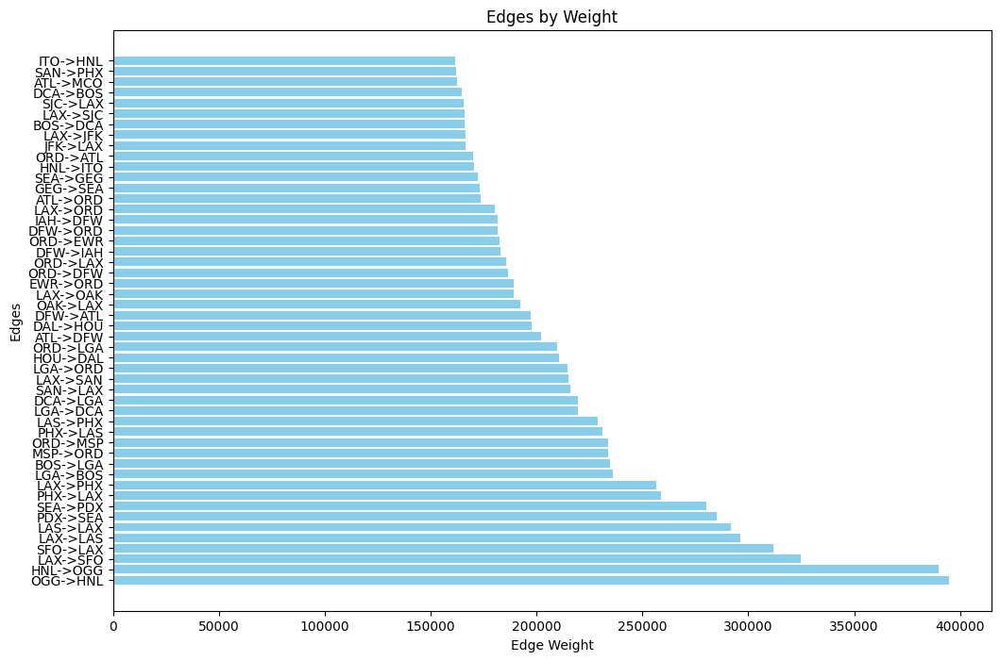

In [175]:
edges_with_weights = [(f"{u}->{v}", data['weight']) for u, v, data in flight_net.edges(data=True) if 'weight' in data]
    
sorted_edges = sorted(edges_with_weights, key=lambda x: x[1], reverse=True)
    
edge_labels, edge_weights = zip(*sorted_edges[:50])
    
# Plot Edges by Weight
plt.figure(figsize=(12, 8))
plt.barh(edge_labels, edge_weights, color='skyblue')
plt.xlabel("Edge Weight")
plt.ylabel("Edges")
plt.title(f"Edges by Weight")
plt.show()

In [176]:
sorted_edges[-50:]

[('LXN->GRI', 1),
 ('MAE->VIS', 1),
 ('PBF->YIP', 1),
 ('WMH->SGF', 1),
 ('MHE->MSY', 1),
 ('MHL->MSY', 1),
 ('SGH->DAY', 1),
 ('SGH->ORD', 1),
 ('SGH->TUL', 1),
 ('SGH->YIP', 1),
 ('MMT->YIP', 1),
 ('MYF->VGT', 1),
 ('MZZ->BNA', 1),
 ('MZZ->CSV', 1),
 ('MZZ->OKC', 1),
 ('RND->COS', 1),
 ('RND->PAM', 1),
 ('VWD->VIS', 1),
 ('OH2->RFD', 1),
 ('OH2->YIP', 1),
 ('OH5->YIP', 1),
 ('SAC->LAX', 1),
 ('SAC->PUB', 1),
 ('SAC->SAN', 1),
 ('TN3->DTW', 1),
 ('TN3->HKS', 1),
 ('TN3->YIP', 1),
 ('PHT->DET', 1),
 ('PHT->SHV', 1),
 ('PMH->RFD', 1),
 ('POU->SLN', 1),
 ('POU->WGO', 1),
 ('RID->JAN', 1),
 ('SEM->JXN', 1),
 ('SIK->YIP', 1),
 ('SLB->WFB', 1),
 ('SVH->CFV', 1),
 ('SVH->HKS', 1),
 ('SVH->MBS', 1),
 ('SVH->SHV', 1),
 ('TBR->SYR', 1),
 ('TMA->SBN', 1),
 ('TMA->SHV', 1),
 ('TN6->LRD', 1),
 ('TN6->MDT', 1),
 ('TN6->TOL', 1),
 ('WBR->GRR', 1),
 ('VWT->DTW', 1),
 ('VWT->STL', 1),
 ('VWT->YIP', 1)]

| Min Threshold | Min-Cut Value | Major Component Size | Number of Minor Components  | Total Number of Components |
|---------------|---------------|----------------------|-----------------------------|----------------------------|
| 1             | 2             | 605                  | 117                         | 118                        |
| 5             | 6             | 606                  | 117                         | 118                        |
| 10            | 11            | 603                  | 114                         | 115                        |
| 15            | 16            | 662                  | 65                          | 66                         |
| 20            | 21            | 606                  | 117                         | 118                        |
| 30            | 31            | 662                  | 65                          | 66                         |
| 50            | 51            | 606                  | 115                         | 116                        |
| 100           | 101           | 661                  | 65                          | 66                         |
| 150           | 163           | 606                  | 117                         | 118                        |
| 175           | 180           | 605                  | 118                         | 119                        |
| 200           | 212           | 660                  | 67                          | 68                         |
| 300           | -             | -                    | -                           | No valid cut found.        |


The table summarizes the results of different minimum threshold values for the cut process applied to a graph, providing insights into the graph's partitioning characteristics:

1. **Min Threshold**: The minimum edge weight considered during the min-cut algorithm. Increasing this threshold filters out smaller edges, potentially leading to larger, more significant partitions.
2. **Min-Cut Value**: The total weight of the edges removed to achieve the graph partitioning. Reflects the "cost" of separating the graph into major and minor components.
3. **Major Component Size**: The size of the largest strongly connected component (SCC) after applying the cut. A larger size suggests the graph's core remains highly connected even after the cut.
4. **Number of Minor Components**: The count of smaller SCCs resulting from the graph partitioning. A higher number indicates that the graph has many disconnected small clusters after the cut.
5. **Total Number of Components**: The sum of the major component and all minor components.

**Conclusions**:
- **Lower thresholds** (1 - 10): Retain most edges, resulting in a larger major component and a smaller number of minor components. These thresholds reveal the highly connected structure of the graph.
- **Higher thresholds** (50 - 200): The higher threshold could decrese the total number of SCCs but it happens time to time without any specific explanation.
- **Threshold Limits** (300): At very high thresholds there are no valid cuts found, indicating that the graph does not have sufficient edge weights meeting the threshold criteria.

Given the structure of the flight network, there is no feasible "minimum number of flights between airports" that can effectively separate the original network into two disconnected subgraphs. This limitation arises from the presence of a single dominant major component with an overwhelming number of flights as edges.

While it is technically possible to "merge" all minor components into one partition, this approach does not yield a meaningful or balanced division. The major component dominates the network with an immense number of connections (some exceeding 400,000), leaving the second partition to manage only a handful of airports with significantly fewer connections.

This disparity highlights the inherent challenge of dividing the network for optimal management by two companies. One company would control a vast, highly connected network, while the other would oversee a much smaller and less significant subset. Consequently, this approach is not optimal for achieving a balanced division of the network.

In [199]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
import community as community_louvain

In [201]:
airports_df = pd.read_csv(r"downloads/Airports2.csv")

## 5. Finding and Extracting Communities

 ***1. In this task, you are asked to analyze the graph and identify the communities based on the flight network provided. For the airline, the primary focus is on the cities, so your communities should reflect the connectivity between cities through the flights that link them.***


Function: `analyze_flight_network`

This function analyzes the flight network based on a given `airports_df` (pandas DataFrame containing flight data) and checks if two cities (`c1`, `c2`) belong to the same community using the **Louvain community detection** algorithm.

1. **Building the Graph**:
   - The `edges` DataFrame is created by selecting `Origin_city`, `Destination_city`, and `Passengers`, then grouping by `Origin_city` and `Destination_city`, summing up passengers to account for multiple flights between cities.
   - A NetworkX graph `G` is created, and edges are added to the graph with the city pairs and passenger count.

2. **Louvain Community Detection**:
   - The `community_louvain.best_partition(G)` function detects communities in the graph `G`. The result is a dictionary `partition` where each key is a city and its value is the community ID to which the city belongs.

3. **Output the Total Number of Communities**:
   - The communities are grouped by their community ID. The function counts and prints the total number of communities and lists the cities in each community.

4. **Subgraph Visualization**:
   - The largest community (based on the number of cities) is identified.
   - A subgraph is created containing only the cities in the largest community.
   - The `spring_layout` function is used for a force-directed layout of the subgraph to improve node spread.
   - The graph is drawn with:
     - **Node colors**: Based on the community each city belongs to.
     - **Edge transparency**: Set to 50% opacity for visual clarity.
     - **Node labels**: Displaying the first 10 cities in the largest community.
     - **Edge labels**: Showing city pairs and passenger counts.

5. **Check if Two Cities Belong to the Same Community**:
   - The function checks if both cities `c1` and `c2` are in the graph and belong to the same community. It prints a message indicating whether they are in the same community or not.

6. **Final Community Overview**:
   - The function prints a summary of all the communities detected, showing the first 10 cities of each community.

Key Libraries/Functions Used:
- **NetworkX (`nx`)**: For creating and analyzing the graph.
- **Community Louvain (`community_louvain`)**: For detecting communities using the Louvain method.
- **Matplotlib (`plt`)**: For graph visualization (subgraph layout, node/edge colors, labels).
- **`spring_layout`**: A layout algorithm for positioning nodes in a visually appealing way.

Summary:
- The function builds a graph from flight data, applies the Louvain community detection method, visualizes the largest community, and checks if two specified cities belong to the same community. It outputs detailed community information and a visualization of the largest community.


In [239]:

def analyze_flight_network(airports_df, c1, c2):
    # Create the graph based on the flight data
    edges = airports_df[['Origin_city', 'Destination_city', 'Passengers']]
    edges = edges.groupby(['Origin_city', 'Destination_city']).agg({'Passengers': 'sum'}).reset_index()

    G = nx.Graph()

    for _, row in edges.iterrows():
        G.add_edge(row['Origin_city'], row['Destination_city'], passengers=row['Passengers'])

    # Apply Louvain community detection
    partition = community_louvain.best_partition(G)

    # 1. Output the total number of communities and the cities in each community
    community_groups = {}
    for city, community_id in partition.items():
        if community_id not in community_groups:
            community_groups[community_id] = []
        community_groups[community_id].append(city)
    
    print(f"Total number of communities: {len(community_groups)}")
    for community_id, cities in community_groups.items():
        print(f"Community {community_id}: {', '.join(cities)}")

    # 2. Subgraph Visualization: Focus on the largest community or top N cities
    largest_community_id = max(community_groups, key=lambda x: len(community_groups[x]))
    largest_community = community_groups[largest_community_id]
    subgraph = G.subgraph(largest_community)

    # Extract community colors for nodes in the subgraph
    subgraph_partition = {city: partition[city] for city in subgraph.nodes()}

    # Force-directed layout with more spread
    pos = nx.spring_layout(subgraph, k=1.0, iterations=50, seed=42)  # Increase 'k' and 'iterations' for better spread

    plt.figure(figsize=(20, 20))  # Larger figure size

    # Draw nodes with colors corresponding to their community
    node_colors = [subgraph_partition[node] for node in subgraph.nodes()]
    nx.draw_networkx_nodes(subgraph, pos, node_size=100, cmap=plt.cm.rainbow, node_color=node_colors)

    # Draw edges with reduced transparency
    nx.draw_networkx_edges(subgraph, pos, alpha=0.5, width=1.0)

    # Draw node labels for hubs or important cities only (adjust for readability)
    labels = {city: city for city in list(largest_community)[:10]}  # Only label the first 10 cities
    nx.draw_networkx_labels(subgraph, pos, labels, font_size=12, font_weight='bold')

    # Draw edge labels with both city names and passenger count on the edge
    edge_labels = {}
    for u, v, d in subgraph.edges(data=True):
        label = f"{u} -> {v}\nPassengers: {d['passengers']}"
        edge_labels[(u, v)] = label

    nx.draw_networkx_edge_labels(subgraph, pos, edge_labels=edge_labels, font_size=8)

    plt.title("Largest Community in Flight Network", fontsize=16)
    plt.axis('off')  # Turn off axis for better visualization
    plt.show()

    # 3. Check if city c1 and c2 belong to the same community
    if c1 in partition and c2 in partition:
        if partition[c1] == partition[c2]:
            print(f"{c1} and {c2} belong to the same community.")
        else:
            print(f"{c1} and {c2} do not belong to the same community.")
    else:
        print(f"One or both of the cities {c1} and {c2} are not in the network.")

    community_groups = {}
    for city, community_id in partition.items():
        if community_id not in community_groups:
            community_groups[community_id] = []
        community_groups[community_id].append(city)

    print(f"\nTotal communities detected: {len(community_groups)}")
    for community_id, cities in community_groups.items():
        print(f"Community {community_id}: {', '.join(cities[:10])}...")

In [ ]:
# you can enter the city you want and check the communities in below marked coloumns

Total number of communities: 5
Community 0: Aberdeen, SD, Brainerd, MN, Eau Claire, WI, Grand Forks, ND, Huron, SD, Jamestown, ND, Mason City, IA, Minneapolis, MN, Omaha, NE, Pierre, SD, Rochester, MN, Sioux Falls, SD, St. Cloud, MN, Watertown, SD, Wausau, WI, Appleton, WI, Cedar Rapids, IA, Chicago, IL, Des Moines, IA, Grand Island, NE, Green Bay, WI, La Crosse, WI, Lincoln, NE, Marquette, MI, Milwaukee, WI, North Platte, NE, Peoria, IL, Scottsbluff, NE, Springfield, MO, Sioux City, IA, Alexandria, MN, Bemidji, MN, Escanaba, MI, Muskegon, MI, Oshkosh, WI, Dubuque, IA, York, PA, Carbondale, IL, Fergus Falls, MN, Owatonna, MN, Clinton, IA, Brookings, SD, Danville, IL, Fort Dodge, IA, Iron Mountain, MI, Springfield, OH, Sterling, CO, Lawrence, KS, Kearney, NE, Shelby, NC, Norfolk, NE, Hastings, NE, Lexington, NE, Mountain Home, AR, Columbus, NE, Coffeyville, KS
Community 1: Anchorage, AK, Billings, MT, Bismarck, ND, Elko, NV, Rapid City, SD, Salt Lake City, UT, Tucson, AZ, Albuquerque, N

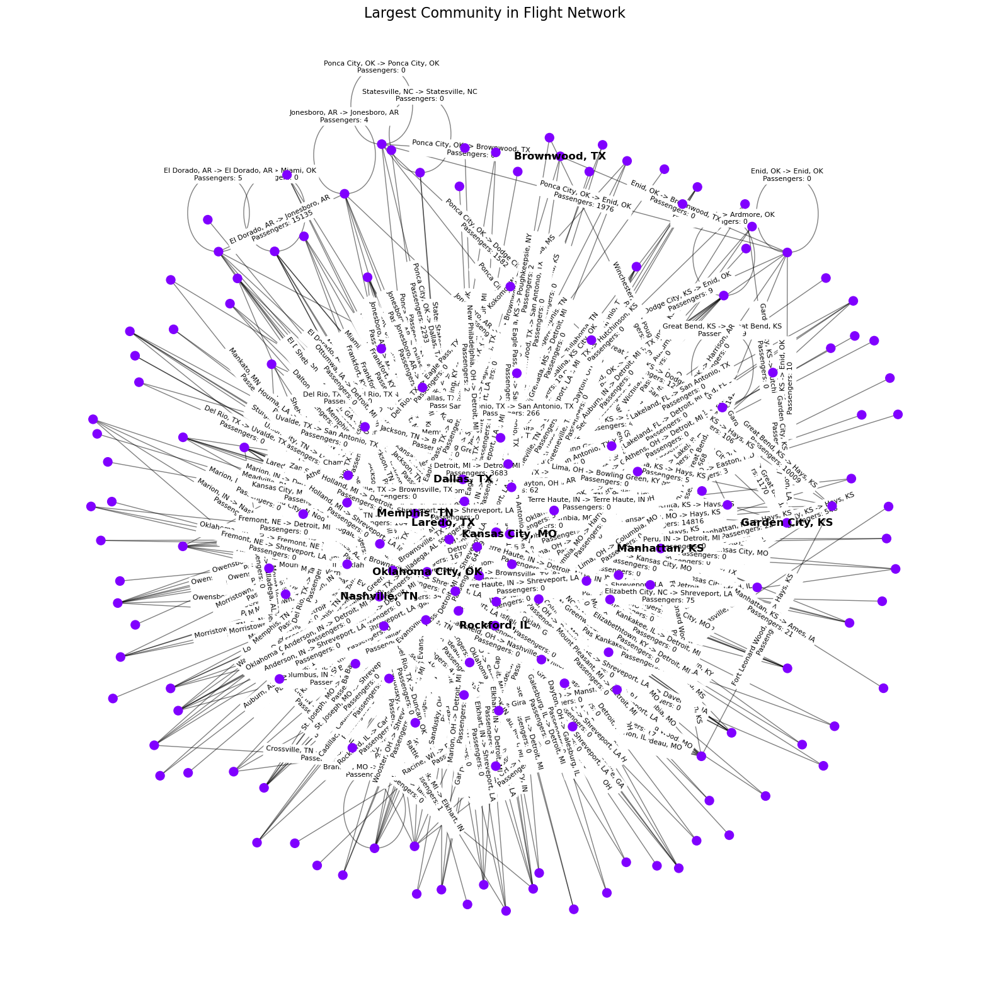

Abilene, TX and Atlanta, GA belong to the same community.

Total communities detected: 5
Community 0: Aberdeen, SD, Brainerd, MN, Eau Claire, WI, Grand Forks, ND, Huron, SD, Jamestown, ND, Mason City, IA, Minneapolis, MN, Omaha, NE, Pierre, SD...
Community 1: Anchorage, AK, Billings, MT, Bismarck, ND, Elko, NV, Rapid City, SD, Salt Lake City, UT, Tucson, AZ, Albuquerque, NM, Amarillo, TX, El Paso, TX...
Community 3: Kansas City, MO, Manhattan, KS, Brownwood, TX, Dallas, TX, Garden City, KS, Laredo, TX, Memphis, TN, Nashville, TN, Oklahoma City, OK, Rockford, IL...
Community 4: Orlando, FL, Abilene, TX, Atlanta, GA, Austin, TX, Beaumont, TX, College Station, TX, Corpus Christi, TX, Jackson, MS, Killeen, TX, Lake Charles, LA...
Community 2: South Bend, IN, Washington, DC, Atlantic City, NJ, Bangor, ME, Boston, MA, Grand Rapids, MI, Indianapolis, IN, Knoxville, TN, New York, NY, Akron, OH...


In [241]:
# Example usage
analyze_flight_network(airports_df, 'Abilene, TX', 'Atlanta, GA')

***2. The Alternative Algorithm suggested by LLM for extracting communities***

In [257]:
import networkx as nx
import matplotlib.pyplot as plt
from networkx.algorithms.community import girvan_newman
import community as community_louvain

def girvan_newman_community_detection(G):
    # Apply the Girvan-Newman algorithm
    communities_generator = girvan_newman(G)
    
    # Retrieve the first set of communities
    first_communities = next(communities_generator)
    
    # Convert communities into a dictionary format
    community_dict = {}
    for i, community in enumerate(first_communities):
        for node in community:
            community_dict[node] = i

    return community_dict, list(first_communities)

def compare_community_detection(airports_df):
    # Build the graph
    edges = airports_df[['Origin_city', 'Destination_city', 'Passengers']]
    edges = edges.groupby(['Origin_city', 'Destination_city']).agg({'Passengers': 'sum'}).reset_index()
    
    G = nx.Graph()
    for _, row in edges.iterrows():
        G.add_edge(row['Origin_city'], row['Destination_city'], passengers=row['Passengers'])

    # Louvain community detection
    louvain_partition = community_louvain.best_partition(G)
    
    # Girvan-Newman community detection
    gn_partition, gn_communities = girvan_newman_community_detection(G)

    # Print Louvain Communities
    print("\n--- Louvain Communities ---")
    louvain_communities = {}
    for node, community_id in louvain_partition.items():
        if community_id not in louvain_communities:
            louvain_communities[community_id] = []
        louvain_communities[community_id].append(node)
    for community_id, cities in louvain_communities.items():
        print(f"Community {community_id}: {len(cities)} cities, example: {', '.join(cities[:5])}...")

    # Print Girvan-Newman Communities
    print("\n--- Girvan-Newman Communities ---")
    for i, community in enumerate(gn_communities):
        print(f"Community {i}: {len(community)} cities, example: {', '.join(list(community)[:5])}...")

    # Visualization
    pos = nx.spring_layout(G, k=0.3, seed=42)

    plt.figure(figsize=(20, 10))

    # Plot Louvain results
    plt.subplot(121)
    louvain_colors = [louvain_partition[node] for node in G.nodes()]
    nx.draw(G, pos, node_size=20, node_color=louvain_colors, cmap=plt.cm.rainbow, alpha=0.8)
    plt.title("Louvain Community Detection", fontsize=16)

    # Plot Girvan-Newman results
    plt.subplot(122)
    gn_colors = [gn_partition[node] if node in gn_partition else 0 for node in G.nodes()]
    nx.draw(G, pos, node_size=20, node_color=gn_colors, cmap=plt.cm.rainbow, alpha=0.8)
    plt.title("Girvan-Newman Community Detection", fontsize=16)

    plt.show()



--- Louvain Communities ---
Community 0: 170 cities, example: Aberdeen, SD, Anchorage, AK, Billings, MT, Bismarck, ND, Brainerd, MN...
Community 2: 120 cities, example: Eau Claire, WI, Orlando, FL, South Bend, IN, Washington, DC, Wausau, WI...
Community 1: 168 cities, example: Kansas City, MO, Manhattan, KS, Mason City, IA, Garden City, KS, Laredo, TX...
Community 3: 105 cities, example: Abilene, TX, Atlanta, GA, Austin, TX, Beaumont, TX, Brownwood, TX...

--- Girvan-Newman Communities ---
Community 0: 562 cities, example: Dothan, AL, Knoxville, TN, Oak Harbor, WA, Bloomington, IL, Orangeburg, SC...
Community 1: 1 cities, example: Blackfoot, ID...


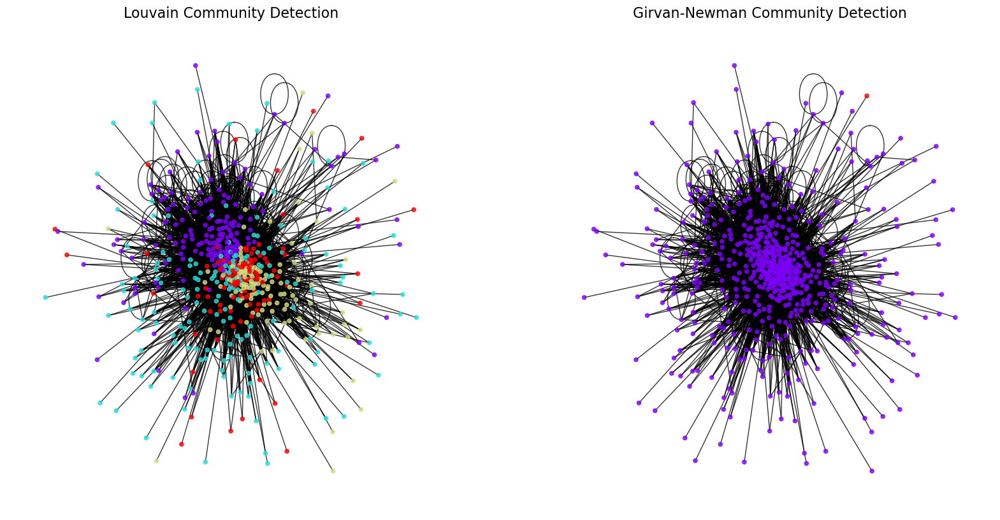

In [259]:
compare_community_detection(airports_df)

Louvain Method:

Pros:
- Greedy optimizing makes it all very scalable to larger networks.
- Runs fast, finds communities of high modularity.

Cons:
- This process is less deterministic, as results depend on initial conditions.
- Prune iteratively. But local minima problem--e.g. may miss smaller communities if modularity low.

Girvan-Newman Method:

Pros:
- More proficient in identifying smaller communities or isolated subpopulations.
- Deterministic, leads to more predictable results.

Cons:
- All this is expensive in terms of calculation, especially for large networks since edge betweenness has to be calculated again and again.
- Risk of prematurely breaking large, connected communities.

Comparison of Results:
- Louvain: May find large, modular communities (especially for dense graphs like flight networks).
- Girvan-Newman: Will probably separate the network into a lot of smaller networks, especially for sparse networks.

Conclusion:
Which Approach is Better: The decision depends on the Graph structure and the purpose of analysis. Due to this, for larger networks, such as the flight dataset, Louvain is usually better as it can scale better, while it also means we make less of a compromise with modularity. The Girvan-Newman algorithm is more useful in cases when you want to, for example, understand hierarchical structures or when focusing on small, well-defined groups.
